In [1]:
# !pip install wandb

In [2]:
import numpy as np 
import pandas as pd 
import os
import wandb
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.nn import Module, Sequential, Conv2d, ConvTranspose2d, LeakyReLU, BatchNorm2d, ReLU, Tanh, Sigmoid, BCELoss , AvgPool2d, Linear
import torchvision.utils as vutils

%matplotlib inline

In [3]:
print("DATASET LOADED")

DATASET LOADED


In [4]:
!wandb login 08836028c4159212c320516a4f9103655dbf9ae6

wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [5]:
wandb.init(project="PEG", entity="bhuvanesh_ai")

wandb: Currently logged in as: bhuvanesh_ai. Use `wandb login --relogin` to force relogin
wandb: wandb version 0.16.4 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
wandb: Tracking run with wandb version 0.16.3
wandb: Run data is saved locally in /kaggle/working/wandb/run-20240308_064102-0y4ndvrd
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run dashing-salad-19
wandb: ⭐️ View project at https://wandb.ai/bhuvanesh_ai/PEG
wandb: 🚀 View run at https://wandb.ai/bhuvanesh_ai/PEG/runs/0y4ndvrd


In [6]:
dir_data = "/kaggle/input/procedural-environment-generation/dataset/dataset"
img_shape = (256,256,1)
img_paths = [dir_data + '/' + file for file in os.listdir(dir_data)]
img_paths = img_paths[:-6]

In [7]:
img_paths = np.sort(img_paths)

In [8]:
def load_images(img_paths):
    for image in img_paths:
        img = Image.open(image)
        img_array = np.array(img)
        img_array_normalized = (img_array - np.min(img_array)) / (np.max(img_array) - np.min(img_array))
        
        yield np.transpose(np.expand_dims(np.float32(img_array_normalized), axis = 2),(2,0,1))

In [9]:
def plot_images(imgs, grid_size = 5):

    fig = plt.figure(figsize = (6,6))
    plt.axis("off")
    columns = rows = grid_size
    plt.title("Training Images")
    images = load_images(imgs)
    for i in range(1, columns*rows +1):
        
        fig.add_subplot(rows, columns, i)
        plt.axis("off")
        plt.imshow(np.transpose(next(images), (1,2,0)), cmap = 'gray')
        
    plt.show()

In [10]:
images = load_images(img_paths)
image = next(images)

In [11]:
image.size

65536

In [12]:
dev = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device = torch.device(dev)

In [13]:
device

device(type='cuda', index=0)

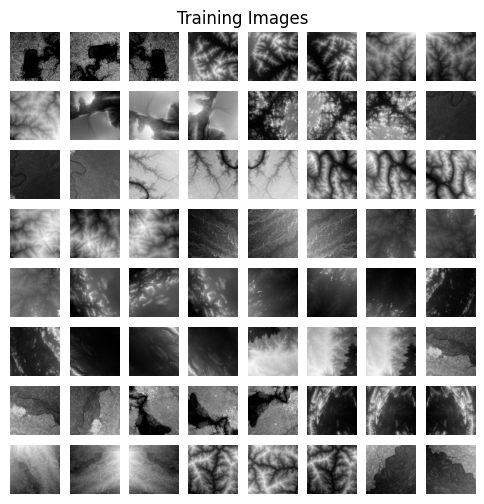

In [14]:
plot_images(img_paths, 8)

In [15]:
class Terrains(Dataset):
    def __init__(self, img_paths):
        '''np array containing all paths to all images'''
        self.img_paths = img_paths
    
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        image = next(load_images([self.img_paths[idx]]))
        return image

In [16]:
dset = Terrains(img_paths)
batch_size = 128
shuffle = True

In [17]:
dataloader = DataLoader(dataset = dset, batch_size = batch_size, shuffle = shuffle, num_workers = 2)

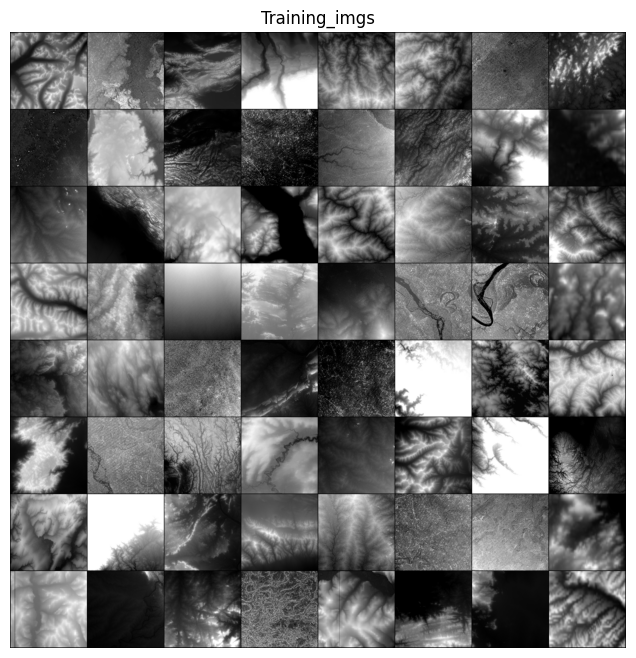

In [18]:
real_batch = next(iter(dataloader))
plt.figure(figsize = (8,8))
plt.axis("off")
plt.title("Training_imgs")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding = 2, normalize=True).cpu(),(1,2,0)), cmap='gray')
plt.show()

In [19]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [20]:
D_lr = 0.00005
G_lr = 0.00005
FILTER_SIZE = 8
BATCH_SIZE = 128

In [21]:
s = 256
s2, s4, s8 = int(s/2), int(s/4), int(s/8)
g_dim = 64
c_dim = 1

In [22]:
# class Generator(Module):
    
    
#     def __init__(self, batch_size, reuse = False):
#         super().__init__()
               
#         output2_shape = [batch_size, g_dim, s4 , s4 ]
#         self.b_conv2 = nn.Parameter(torch.ones(output2_shape[1]) * 0.1)
#         self.resize_layer2 = nn.Upsample(size=(output2_shape[2], output2_shape[3]), mode='nearest')
#         self.conv2 = nn.Conv2d(in_channels=g_dim, out_channels=s4, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
#         self.batch_norm2 = nn.BatchNorm2d(s4)
        
#         output3_shape = [batch_size,g_dim*2, s2 , s2 ]
#         self.b_conv3 = nn.Parameter(torch.ones(output3_shape[1]) * 0.1)
#         self.resize_layer3 = nn.Upsample(size=(output3_shape[2], output3_shape[3]), mode='nearest')
#         self.conv3 = nn.Conv2d(in_channels=g_dim, out_channels=s8, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
#         self.batch_norm3 = nn.BatchNorm2d(s8)
        
#         output4_shape = [batch_size, c_dim, s, s]
#         self.b_conv4 = nn.Parameter(torch.ones(output4_shape[1]) * 0.1)
#         self.resize_layer4 = nn.Upsample(size=(output4_shape[2], output4_shape[3]), mode='nearest')
#         self.conv4 = nn.Conv2d(in_channels=s8, out_channels=1, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        
#     def forward(self, z):
#         batch_temp = z.shape[0]
#         h0 = torch.reshape(z, [batch_temp, 64,s8,s8])
#         h0 = LeakyReLU()(h0)
# #         print(h0.shape)
#         h_conv2 = self.resize_layer2(h0) + self.b_conv2
# #         print(h_conv2.shape)
#         h_conv2 = self.conv2(h_conv2)
# #         print(h_conv2.shape)
#         h_conv2 = LeakyReLU()(h_conv2)
#         h_conv2 = self.batch_norm2(h_conv2)
#         h_conv2 = LeakyReLU()(h_conv2)
        
#         h_conv3 = self.resize_layer3(h_conv2) + self.b_conv3
# #         print(h_conv3.shape)
#         h_conv3 = self.conv3(h_conv3)
# #         print(h_conv3.shape)
#         h_conv3 = LeakyReLU()(h_conv3)
#         h_conv3 = self.batch_norm3(h_conv3)
#         h_conv3 = LeakyReLU()(h_conv3)
        
#         h_conv4 = self.resize_layer4(h_conv3) + self.b_conv4
# #         print(h_conv4.shape)
#         h_conv4 = self.conv4(h_conv4)
# #         print(h_conv4.shape)
#         h_conv4 = LeakyReLU()(h_conv4)
#         h_conv4 = Tanh()(h_conv4)
        
#         return h_conv4

In [23]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is a random noise vector of size nz
            # Output: (ngf * 16) x 4 x 4 (initial layer is doubled for larger image)
            nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),

            # Output: (ngf * 8) x 8 x 8
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # Output: (ngf * 4) x 16 x 16
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # Output: (ngf * 2) x 32 x 32
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # Output: (ngf) x 64 x 64
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # Output: (nc) x 256 x 256
            nn.ConvTranspose2d(ngf, nc, 4, 4, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)


In [24]:
# class Discriminator(Module):
#     def __init__(self):
#         super().__init__()
#         self.leaky_relu = LeakyReLU()
#         #256x256x1
#         self.conv1 = Conv2d(in_channels=1, out_channels= 8 , kernel_size = 5, stride = 1, padding=1, bias = False)
#         #leaky relu here
#         #256x256x8
#         self.pool1 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
#         #128x128x8
#         self.conv2 = Conv2d(in_channels=8, out_channels= 16 , kernel_size = 5, stride = 1, padding=1,  bias = False)
# #         LeakyRelu here
#         #128x128x16
#         self.pool2 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
#         #64x64x16
#         #add flatten
#         self.dimval = 64*64*16
        
#         self.fc1 = Linear(self.dimval, 32,  bias = False)
# #         LeakyReLU here
#         self.fc2 = Linear(32, 1,  bias = False)
# #         self.sigmoid = nn.Sigmoid()
        
#     def forward(self, inputs):
# #         print(inputs.shape)
#         x = self.conv1(inputs)
# #         print(x.shape)
#         x = self.leaky_relu(x)
# #         print(x.shape)
#         x = self.pool1(x)
# #         print(x.shape)
#         x = self.conv2(x)
# #         print(x.shape)
#         x = self.leaky_relu(x)
# #         print(x.shape)
#         x = self.pool2(x)
# #         print(x.shape)
        
#         x = torch.reshape(x, [x.shape[0], self.dimval])
        
#         x = self.fc1(x)
#         x = self.leaky_relu(x)
        
#         x =  self.fc2(x)
# #         output = self.sigmoid(x)
#         return x

In [25]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 256 x 256
            nn.Conv2d(nc, ndf, 4, 4, 0, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size: (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # state size: (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size: (ndf*4) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size: (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [26]:
ngpu = 2
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

In [27]:
checkpoint = torch.load("/kaggle/input/lastgan/last_GAN.pt")

In [28]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
# netG.apply(weights_init)
netG.load_state_dict(checkpoint['Gen_state_dict'])

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), strid

In [29]:
netD = Discriminator(ngpu).to(device)
# # Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
# netD.apply(weights_init)
netD.load_state_dict(checkpoint['Disc_state_dict'])


# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(4, 4), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (12): Sigmoid(

In [30]:
def filtered_params(model):
    return [param for name, param in model.named_parameters() if 'batch' not in name]
params = filtered_params(netG)

In [31]:
fixed_noise = torch.randn(batch_size, 100, 1,1,device = device)

In [32]:
real_label = 1
fake_label = 0

In [33]:
workers = 2
num_epochs = 86
beta1 = 0.5

In [34]:
optimizerD = optim.RMSprop(netD.parameters(), lr = D_lr)
optimizerD.load_state_dict(checkpoint['optimizerD_state_dict'])
optimizerG = optim.RMSprop(netG.parameters(), lr = G_lr)
optimizerG.load_state_dict(checkpoint['optimizerG_state_dict'])

In [35]:
device

device(type='cuda', index=0)

In [36]:
!mkdir checkpoints

Starting Training Loop...
[66/86][0/660]	Loss_D: -0.0496	Loss_G: -0.5219	D(x): 0.5611	D(G(z)): 0.5115 / 0.5219
[66/86][50/660]	Loss_D: -0.0328	Loss_G: -0.5229	D(x): 0.5394	D(G(z)): 0.5066 / 0.5229
[66/86][100/660]	Loss_D: -0.0329	Loss_G: -0.5201	D(x): 0.5425	D(G(z)): 0.5096 / 0.5201
[66/86][150/660]	Loss_D: -0.0244	Loss_G: -0.5232	D(x): 0.5486	D(G(z)): 0.5243 / 0.5232
[66/86][200/660]	Loss_D: -0.0448	Loss_G: -0.5169	D(x): 0.5554	D(G(z)): 0.5106 / 0.5169
[66/86][250/660]	Loss_D: -0.0426	Loss_G: -0.5283	D(x): 0.5454	D(G(z)): 0.5027 / 0.5283
[66/86][300/660]	Loss_D: -0.0212	Loss_G: -0.5248	D(x): 0.5688	D(G(z)): 0.5476 / 0.5248
[66/86][350/660]	Loss_D: -0.0487	Loss_G: -0.5039	D(x): 0.5648	D(G(z)): 0.5161 / 0.5039
[66/86][400/660]	Loss_D: -0.0357	Loss_G: -0.4926	D(x): 0.5714	D(G(z)): 0.5357 / 0.4926
[66/86][450/660]	Loss_D: -0.0355	Loss_G: -0.4993	D(x): 0.5675	D(G(z)): 0.5321 / 0.4993
[66/86][500/660]	Loss_D: -0.0367	Loss_G: -0.5026	D(x): 0.5760	D(G(z)): 0.5392 / 0.5026
[66/86][550/660]	Los

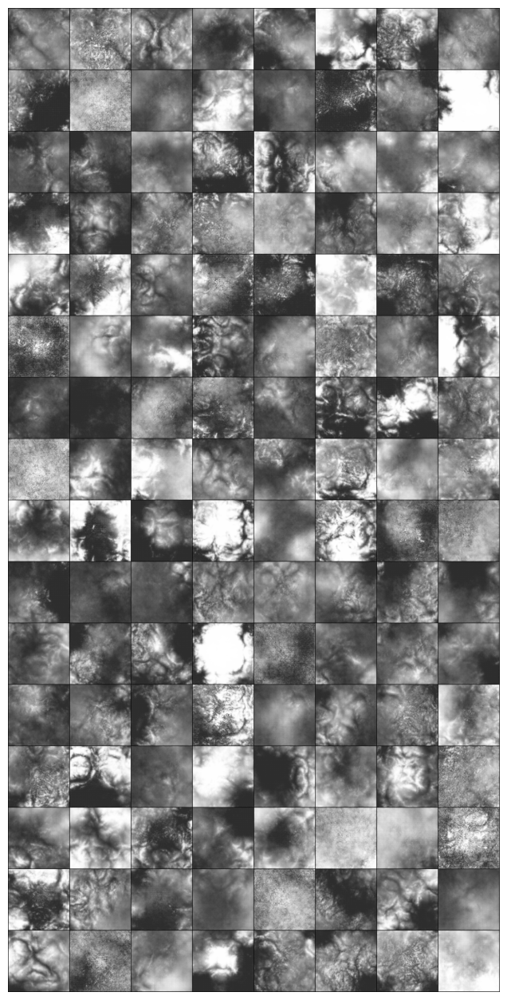

saved epoch 66
[67/86][0/660]	Loss_D: -0.0336	Loss_G: -0.5113	D(x): 0.5509	D(G(z)): 0.5173 / 0.5113
[67/86][50/660]	Loss_D: -0.0415	Loss_G: -0.5160	D(x): 0.5661	D(G(z)): 0.5246 / 0.5160
[67/86][100/660]	Loss_D: -0.0354	Loss_G: -0.5199	D(x): 0.5449	D(G(z)): 0.5094 / 0.5199
[67/86][150/660]	Loss_D: -0.0284	Loss_G: -0.5517	D(x): 0.5344	D(G(z)): 0.5060 / 0.5517
[67/86][200/660]	Loss_D: -0.0293	Loss_G: -0.5240	D(x): 0.5545	D(G(z)): 0.5252 / 0.5240
[67/86][250/660]	Loss_D: -0.0337	Loss_G: -0.5060	D(x): 0.5909	D(G(z)): 0.5572 / 0.5060
[67/86][300/660]	Loss_D: -0.0355	Loss_G: -0.5104	D(x): 0.5716	D(G(z)): 0.5362 / 0.5104
[67/86][350/660]	Loss_D: -0.0335	Loss_G: -0.5276	D(x): 0.5474	D(G(z)): 0.5140 / 0.5276
[67/86][400/660]	Loss_D: -0.0390	Loss_G: -0.5154	D(x): 0.5658	D(G(z)): 0.5268 / 0.5154
[67/86][450/660]	Loss_D: -0.0321	Loss_G: -0.5371	D(x): 0.5461	D(G(z)): 0.5140 / 0.5371
[67/86][500/660]	Loss_D: -0.0389	Loss_G: -0.5193	D(x): 0.5587	D(G(z)): 0.5198 / 0.5193
[67/86][550/660]	Loss_D: -0.027

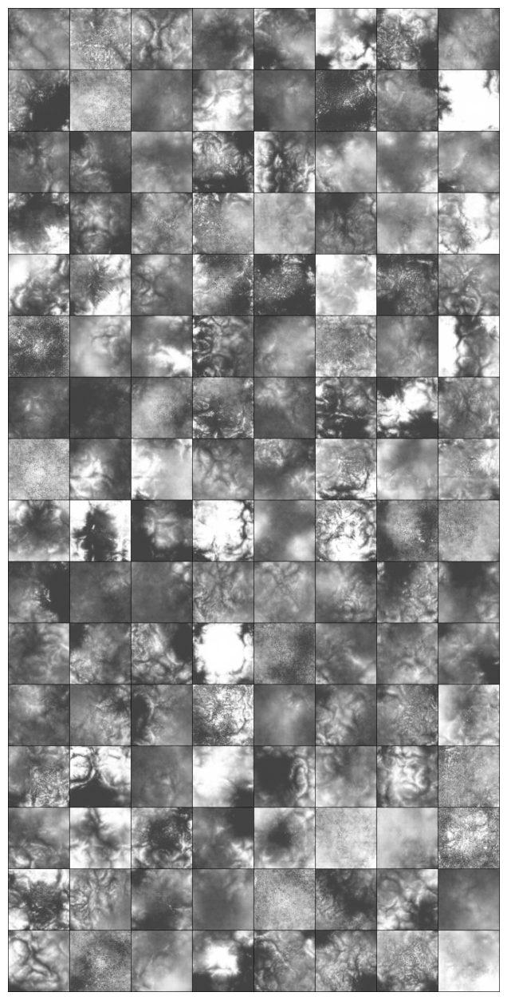

saved epoch 67
[68/86][0/660]	Loss_D: -0.0470	Loss_G: -0.5000	D(x): 0.5806	D(G(z)): 0.5335 / 0.5000
[68/86][50/660]	Loss_D: -0.0312	Loss_G: -0.5149	D(x): 0.5616	D(G(z)): 0.5303 / 0.5149
[68/86][100/660]	Loss_D: -0.0255	Loss_G: -0.5250	D(x): 0.5814	D(G(z)): 0.5560 / 0.5250
[68/86][150/660]	Loss_D: -0.0347	Loss_G: -0.5215	D(x): 0.5594	D(G(z)): 0.5247 / 0.5215
[68/86][200/660]	Loss_D: -0.0234	Loss_G: -0.5361	D(x): 0.5467	D(G(z)): 0.5233 / 0.5361
[68/86][250/660]	Loss_D: -0.0162	Loss_G: -0.5365	D(x): 0.5582	D(G(z)): 0.5420 / 0.5365
[68/86][300/660]	Loss_D: -0.0367	Loss_G: -0.5172	D(x): 0.5484	D(G(z)): 0.5117 / 0.5172
[68/86][350/660]	Loss_D: -0.0413	Loss_G: -0.4893	D(x): 0.5806	D(G(z)): 0.5393 / 0.4893
[68/86][400/660]	Loss_D: -0.0384	Loss_G: -0.5074	D(x): 0.5670	D(G(z)): 0.5286 / 0.5074
[68/86][450/660]	Loss_D: -0.0283	Loss_G: -0.5439	D(x): 0.5333	D(G(z)): 0.5049 / 0.5439
[68/86][500/660]	Loss_D: -0.0335	Loss_G: -0.5170	D(x): 0.5608	D(G(z)): 0.5273 / 0.5170
[68/86][550/660]	Loss_D: -0.031

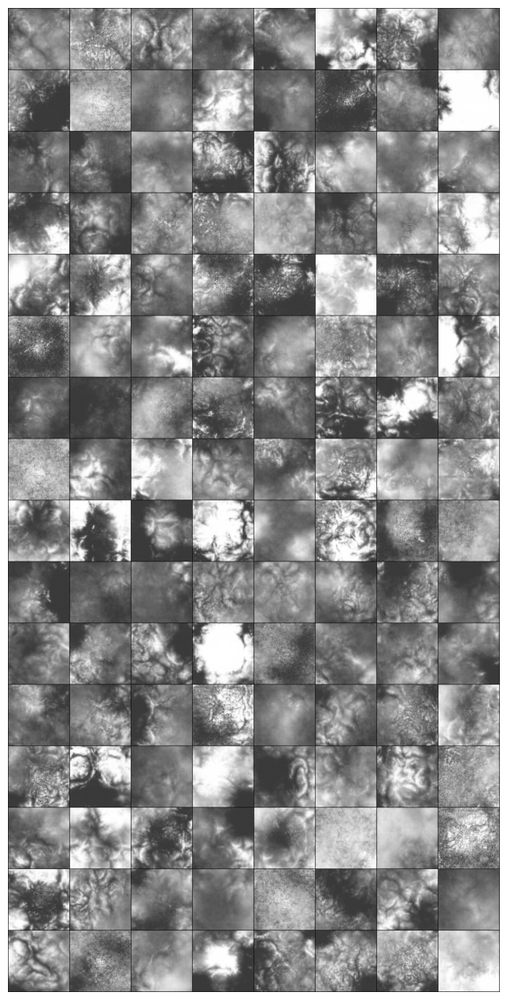

saved epoch 68
[69/86][0/660]	Loss_D: -0.0386	Loss_G: -0.5097	D(x): 0.5625	D(G(z)): 0.5239 / 0.5097
[69/86][50/660]	Loss_D: -0.0300	Loss_G: -0.5097	D(x): 0.5593	D(G(z)): 0.5293 / 0.5097
[69/86][100/660]	Loss_D: -0.0387	Loss_G: -0.4969	D(x): 0.5693	D(G(z)): 0.5306 / 0.4969
[69/86][150/660]	Loss_D: -0.0318	Loss_G: -0.5228	D(x): 0.5483	D(G(z)): 0.5165 / 0.5228
[69/86][200/660]	Loss_D: -0.0264	Loss_G: -0.5173	D(x): 0.5638	D(G(z)): 0.5374 / 0.5173
[69/86][250/660]	Loss_D: -0.0345	Loss_G: -0.5001	D(x): 0.5674	D(G(z)): 0.5329 / 0.5001
[69/86][300/660]	Loss_D: -0.0319	Loss_G: -0.5133	D(x): 0.5711	D(G(z)): 0.5392 / 0.5133
[69/86][350/660]	Loss_D: -0.0245	Loss_G: -0.5202	D(x): 0.5235	D(G(z)): 0.4990 / 0.5202
[69/86][400/660]	Loss_D: -0.0326	Loss_G: -0.5363	D(x): 0.5572	D(G(z)): 0.5245 / 0.5363
[69/86][450/660]	Loss_D: -0.0323	Loss_G: -0.5072	D(x): 0.5493	D(G(z)): 0.5170 / 0.5072
[69/86][500/660]	Loss_D: -0.0414	Loss_G: -0.5202	D(x): 0.5653	D(G(z)): 0.5239 / 0.5202
[69/86][550/660]	Loss_D: -0.035

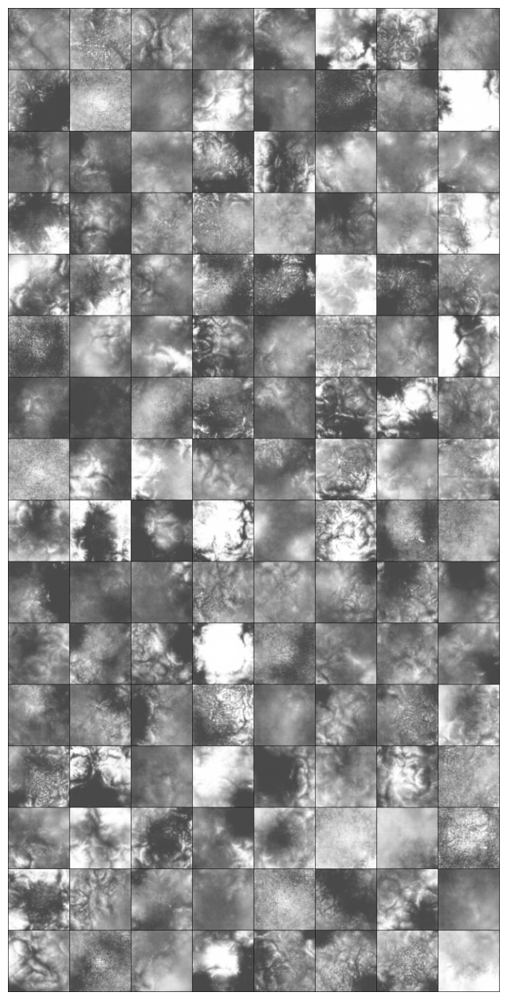

saved epoch 69
[70/86][0/660]	Loss_D: -0.0363	Loss_G: -0.5253	D(x): 0.5641	D(G(z)): 0.5278 / 0.5253
[70/86][50/660]	Loss_D: -0.0157	Loss_G: -0.5472	D(x): 0.5823	D(G(z)): 0.5666 / 0.5472
[70/86][100/660]	Loss_D: -0.0516	Loss_G: -0.5296	D(x): 0.5596	D(G(z)): 0.5080 / 0.5296
[70/86][150/660]	Loss_D: -0.0368	Loss_G: -0.5495	D(x): 0.5570	D(G(z)): 0.5202 / 0.5495
[70/86][200/660]	Loss_D: -0.0303	Loss_G: -0.5046	D(x): 0.5707	D(G(z)): 0.5404 / 0.5046
[70/86][250/660]	Loss_D: -0.0298	Loss_G: -0.5298	D(x): 0.5681	D(G(z)): 0.5383 / 0.5298
[70/86][300/660]	Loss_D: -0.0355	Loss_G: -0.5247	D(x): 0.5552	D(G(z)): 0.5197 / 0.5247
[70/86][350/660]	Loss_D: -0.0318	Loss_G: -0.5307	D(x): 0.5531	D(G(z)): 0.5213 / 0.5307
[70/86][400/660]	Loss_D: -0.0298	Loss_G: -0.5519	D(x): 0.5370	D(G(z)): 0.5071 / 0.5519
[70/86][450/660]	Loss_D: -0.0374	Loss_G: -0.5210	D(x): 0.5515	D(G(z)): 0.5141 / 0.5210
[70/86][500/660]	Loss_D: -0.0546	Loss_G: -0.5221	D(x): 0.5733	D(G(z)): 0.5188 / 0.5221
[70/86][550/660]	Loss_D: -0.032

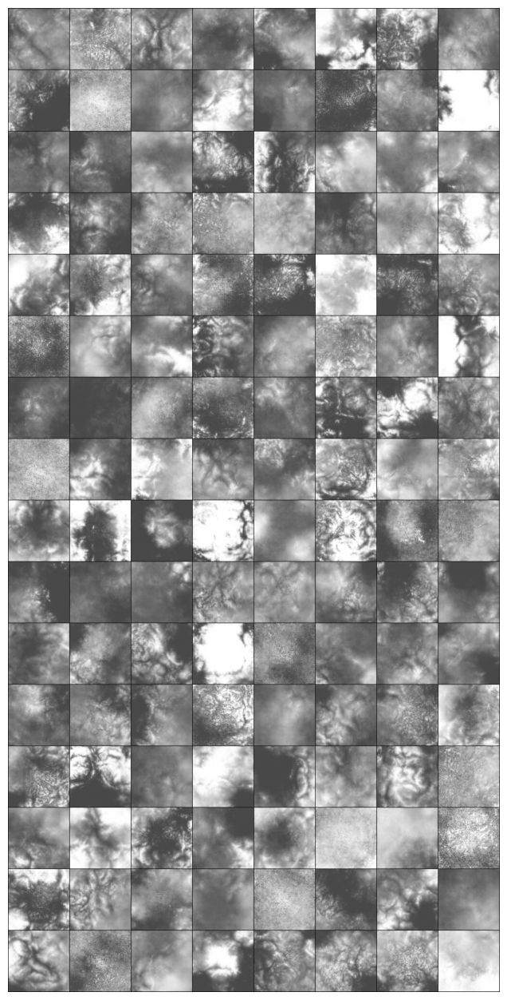

saved epoch 70
[71/86][0/660]	Loss_D: -0.0309	Loss_G: -0.5347	D(x): 0.5554	D(G(z)): 0.5245 / 0.5347
[71/86][50/660]	Loss_D: -0.0458	Loss_G: -0.5217	D(x): 0.5676	D(G(z)): 0.5219 / 0.5217
[71/86][100/660]	Loss_D: -0.0329	Loss_G: -0.5377	D(x): 0.5535	D(G(z)): 0.5206 / 0.5377
[71/86][150/660]	Loss_D: -0.0272	Loss_G: -0.5393	D(x): 0.5374	D(G(z)): 0.5102 / 0.5393
[71/86][200/660]	Loss_D: -0.0395	Loss_G: -0.5123	D(x): 0.5669	D(G(z)): 0.5274 / 0.5123
[71/86][250/660]	Loss_D: -0.0262	Loss_G: -0.5297	D(x): 0.5670	D(G(z)): 0.5408 / 0.5297
[71/86][300/660]	Loss_D: -0.0221	Loss_G: -0.5520	D(x): 0.5429	D(G(z)): 0.5208 / 0.5520
[71/86][350/660]	Loss_D: -0.0337	Loss_G: -0.5349	D(x): 0.5585	D(G(z)): 0.5248 / 0.5349
[71/86][400/660]	Loss_D: -0.0322	Loss_G: -0.5203	D(x): 0.5584	D(G(z)): 0.5262 / 0.5203
[71/86][450/660]	Loss_D: -0.0238	Loss_G: -0.5345	D(x): 0.5598	D(G(z)): 0.5360 / 0.5345
[71/86][500/660]	Loss_D: -0.0400	Loss_G: -0.5241	D(x): 0.5664	D(G(z)): 0.5264 / 0.5241
[71/86][550/660]	Loss_D: -0.049

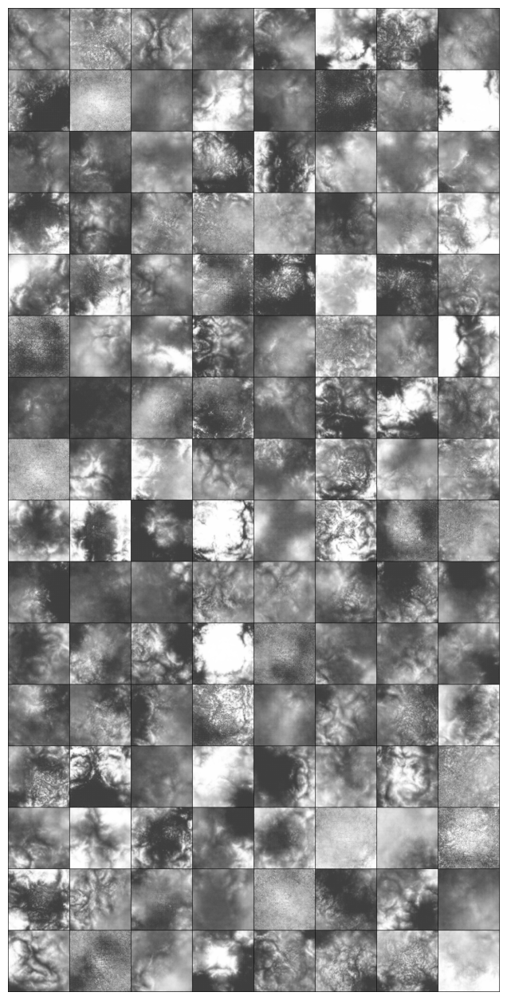

saved epoch 71
[72/86][0/660]	Loss_D: -0.0408	Loss_G: -0.5164	D(x): 0.5614	D(G(z)): 0.5206 / 0.5164
[72/86][50/660]	Loss_D: -0.0328	Loss_G: -0.5033	D(x): 0.5780	D(G(z)): 0.5452 / 0.5033
[72/86][100/660]	Loss_D: -0.0320	Loss_G: -0.5234	D(x): 0.5847	D(G(z)): 0.5527 / 0.5234
[72/86][150/660]	Loss_D: -0.0347	Loss_G: -0.5326	D(x): 0.5473	D(G(z)): 0.5126 / 0.5326
[72/86][200/660]	Loss_D: -0.0321	Loss_G: -0.5249	D(x): 0.5550	D(G(z)): 0.5229 / 0.5249
[72/86][250/660]	Loss_D: -0.0219	Loss_G: -0.5538	D(x): 0.5371	D(G(z)): 0.5152 / 0.5538
[72/86][300/660]	Loss_D: -0.0271	Loss_G: -0.5299	D(x): 0.5310	D(G(z)): 0.5039 / 0.5299
[72/86][350/660]	Loss_D: -0.0328	Loss_G: -0.5187	D(x): 0.5606	D(G(z)): 0.5278 / 0.5187
[72/86][400/660]	Loss_D: -0.0267	Loss_G: -0.5209	D(x): 0.5899	D(G(z)): 0.5632 / 0.5209
[72/86][450/660]	Loss_D: -0.0245	Loss_G: -0.5302	D(x): 0.5633	D(G(z)): 0.5389 / 0.5302
[72/86][500/660]	Loss_D: -0.0470	Loss_G: -0.5175	D(x): 0.5675	D(G(z)): 0.5205 / 0.5175
[72/86][550/660]	Loss_D: -0.037

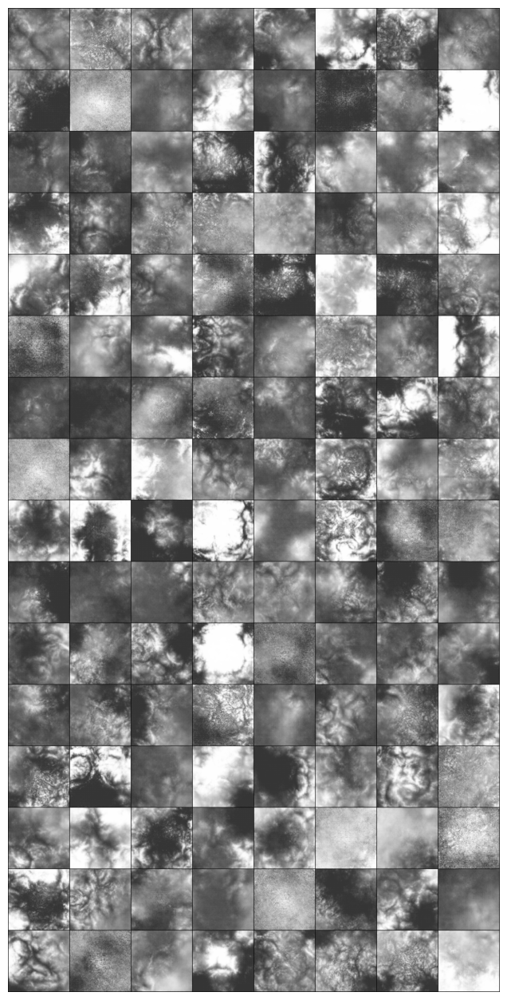

saved epoch 72
[73/86][0/660]	Loss_D: -0.0258	Loss_G: -0.5312	D(x): 0.5522	D(G(z)): 0.5264 / 0.5312
[73/86][50/660]	Loss_D: -0.0319	Loss_G: -0.5326	D(x): 0.5707	D(G(z)): 0.5387 / 0.5326
[73/86][100/660]	Loss_D: -0.0419	Loss_G: -0.5490	D(x): 0.5577	D(G(z)): 0.5158 / 0.5490
[73/86][150/660]	Loss_D: -0.0334	Loss_G: -0.5382	D(x): 0.5615	D(G(z)): 0.5281 / 0.5382
[73/86][200/660]	Loss_D: -0.0209	Loss_G: -0.5144	D(x): 0.5669	D(G(z)): 0.5459 / 0.5144
[73/86][250/660]	Loss_D: -0.0268	Loss_G: -0.5211	D(x): 0.5625	D(G(z)): 0.5358 / 0.5211
[73/86][300/660]	Loss_D: -0.0372	Loss_G: -0.5021	D(x): 0.5737	D(G(z)): 0.5365 / 0.5021
[73/86][350/660]	Loss_D: -0.0413	Loss_G: -0.5228	D(x): 0.5689	D(G(z)): 0.5276 / 0.5228
[73/86][400/660]	Loss_D: -0.0220	Loss_G: -0.5229	D(x): 0.5688	D(G(z)): 0.5468 / 0.5229
[73/86][450/660]	Loss_D: -0.0262	Loss_G: -0.5353	D(x): 0.5373	D(G(z)): 0.5112 / 0.5353
[73/86][500/660]	Loss_D: -0.0236	Loss_G: -0.5459	D(x): 0.5356	D(G(z)): 0.5120 / 0.5459
[73/86][550/660]	Loss_D: -0.034

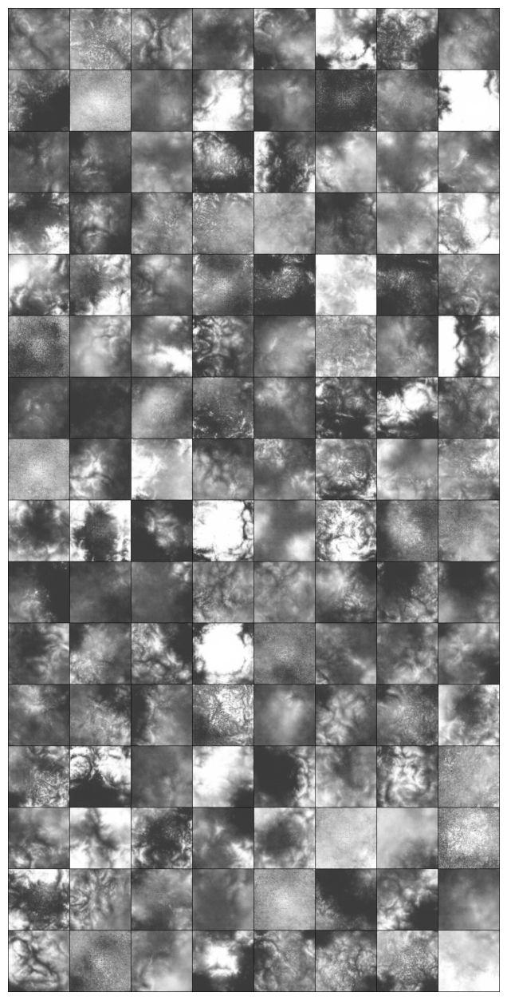

saved epoch 73
[74/86][0/660]	Loss_D: -0.0327	Loss_G: -0.5279	D(x): 0.5561	D(G(z)): 0.5234 / 0.5279
[74/86][50/660]	Loss_D: -0.0310	Loss_G: -0.5143	D(x): 0.5707	D(G(z)): 0.5397 / 0.5143
[74/86][100/660]	Loss_D: -0.0243	Loss_G: -0.5299	D(x): 0.5402	D(G(z)): 0.5159 / 0.5299
[74/86][150/660]	Loss_D: -0.0139	Loss_G: -0.5273	D(x): 0.5743	D(G(z)): 0.5605 / 0.5273
[74/86][200/660]	Loss_D: -0.0198	Loss_G: -0.5308	D(x): 0.5540	D(G(z)): 0.5342 / 0.5308
[74/86][250/660]	Loss_D: -0.0302	Loss_G: -0.5086	D(x): 0.5815	D(G(z)): 0.5513 / 0.5086
[74/86][300/660]	Loss_D: -0.0221	Loss_G: -0.5401	D(x): 0.5503	D(G(z)): 0.5282 / 0.5401
[74/86][350/660]	Loss_D: -0.0183	Loss_G: -0.5361	D(x): 0.5423	D(G(z)): 0.5240 / 0.5361
[74/86][400/660]	Loss_D: -0.0318	Loss_G: -0.5099	D(x): 0.5695	D(G(z)): 0.5377 / 0.5099
[74/86][450/660]	Loss_D: -0.0303	Loss_G: -0.5357	D(x): 0.5599	D(G(z)): 0.5296 / 0.5357
[74/86][500/660]	Loss_D: -0.0194	Loss_G: -0.5404	D(x): 0.5842	D(G(z)): 0.5648 / 0.5404
[74/86][550/660]	Loss_D: -0.034

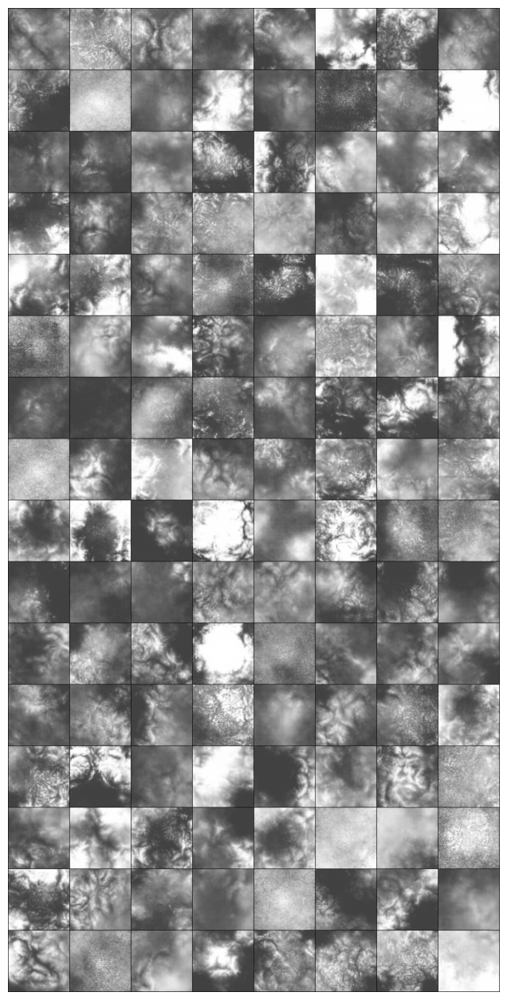

saved epoch 74
[75/86][0/660]	Loss_D: -0.0213	Loss_G: -0.5249	D(x): 0.5729	D(G(z)): 0.5516 / 0.5249
[75/86][50/660]	Loss_D: -0.0280	Loss_G: -0.5332	D(x): 0.5469	D(G(z)): 0.5189 / 0.5332
[75/86][100/660]	Loss_D: -0.0314	Loss_G: -0.5374	D(x): 0.5560	D(G(z)): 0.5246 / 0.5374
[75/86][150/660]	Loss_D: -0.0324	Loss_G: -0.5186	D(x): 0.5628	D(G(z)): 0.5304 / 0.5186
[75/86][200/660]	Loss_D: -0.0313	Loss_G: -0.5459	D(x): 0.5511	D(G(z)): 0.5199 / 0.5459
[75/86][250/660]	Loss_D: -0.0286	Loss_G: -0.5177	D(x): 0.5772	D(G(z)): 0.5486 / 0.5177
[75/86][300/660]	Loss_D: -0.0285	Loss_G: -0.4999	D(x): 0.5813	D(G(z)): 0.5527 / 0.4999
[75/86][350/660]	Loss_D: -0.0322	Loss_G: -0.5236	D(x): 0.5702	D(G(z)): 0.5380 / 0.5236
[75/86][400/660]	Loss_D: -0.0293	Loss_G: -0.4980	D(x): 0.5848	D(G(z)): 0.5555 / 0.4980
[75/86][450/660]	Loss_D: -0.0253	Loss_G: -0.5112	D(x): 0.5788	D(G(z)): 0.5535 / 0.5112
[75/86][500/660]	Loss_D: -0.0266	Loss_G: -0.5114	D(x): 0.5404	D(G(z)): 0.5137 / 0.5114
[75/86][550/660]	Loss_D: -0.051

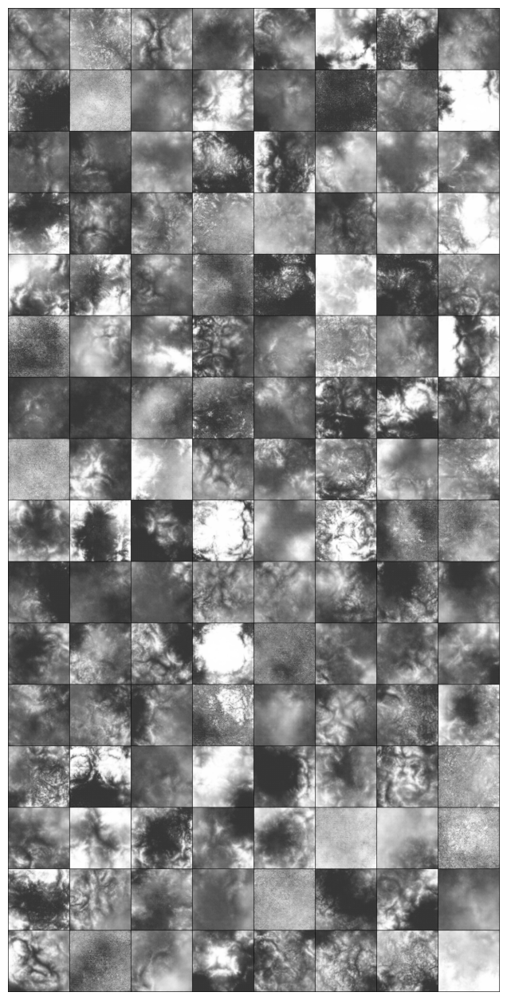

saved epoch 75
[76/86][0/660]	Loss_D: -0.0233	Loss_G: -0.5108	D(x): 0.4937	D(G(z)): 0.4703 / 0.5108
[76/86][50/660]	Loss_D: -0.0277	Loss_G: -0.4665	D(x): 0.5221	D(G(z)): 0.4944 / 0.4665
[76/86][100/660]	Loss_D: -0.0227	Loss_G: -0.4702	D(x): 0.5275	D(G(z)): 0.5048 / 0.4702
[76/86][150/660]	Loss_D: -0.0353	Loss_G: -0.4705	D(x): 0.5217	D(G(z)): 0.4864 / 0.4705
[76/86][200/660]	Loss_D: -0.0241	Loss_G: -0.4695	D(x): 0.4941	D(G(z)): 0.4700 / 0.4695
[76/86][250/660]	Loss_D: -0.0291	Loss_G: -0.4712	D(x): 0.4981	D(G(z)): 0.4690 / 0.4712
[76/86][300/660]	Loss_D: -0.0268	Loss_G: -0.4780	D(x): 0.4961	D(G(z)): 0.4693 / 0.4780
[76/86][350/660]	Loss_D: -0.0326	Loss_G: -0.4806	D(x): 0.4967	D(G(z)): 0.4641 / 0.4806
[76/86][400/660]	Loss_D: -0.0091	Loss_G: -0.4776	D(x): 0.5231	D(G(z)): 0.5140 / 0.4776
[76/86][450/660]	Loss_D: -0.0266	Loss_G: -0.4813	D(x): 0.4912	D(G(z)): 0.4646 / 0.4813
[76/86][500/660]	Loss_D: -0.0322	Loss_G: -0.4983	D(x): 0.5057	D(G(z)): 0.4735 / 0.4983
[76/86][550/660]	Loss_D: -0.032

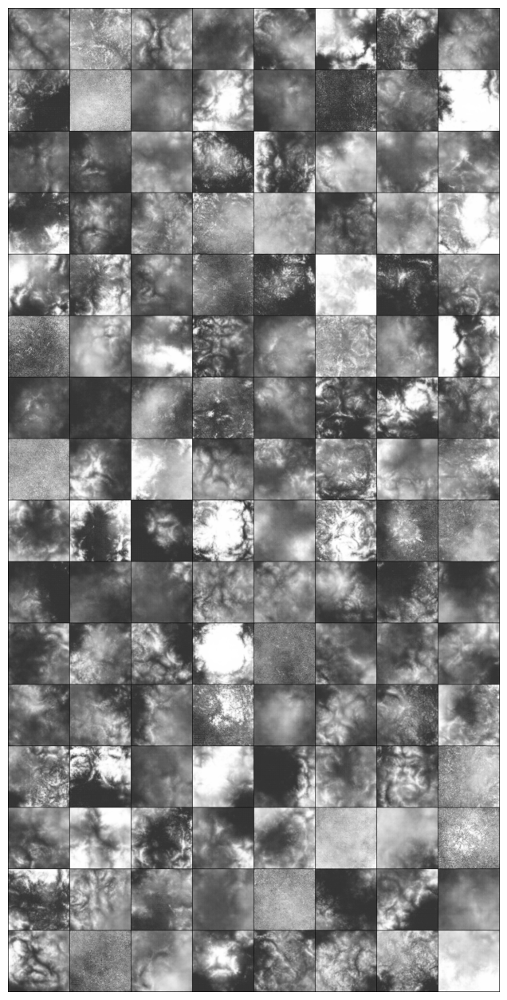

saved epoch 76
[77/86][0/660]	Loss_D: -0.0341	Loss_G: -0.4562	D(x): 0.4993	D(G(z)): 0.4652 / 0.4562
[77/86][50/660]	Loss_D: -0.0247	Loss_G: -0.4768	D(x): 0.5011	D(G(z)): 0.4764 / 0.4768
[77/86][100/660]	Loss_D: -0.0141	Loss_G: -0.4787	D(x): 0.4970	D(G(z)): 0.4829 / 0.4787
[77/86][150/660]	Loss_D: -0.0278	Loss_G: -0.4922	D(x): 0.4769	D(G(z)): 0.4492 / 0.4922
[77/86][200/660]	Loss_D: -0.0250	Loss_G: -0.4863	D(x): 0.4856	D(G(z)): 0.4606 / 0.4863
[77/86][250/660]	Loss_D: -0.0278	Loss_G: -0.4853	D(x): 0.5001	D(G(z)): 0.4723 / 0.4853
[77/86][300/660]	Loss_D: -0.0306	Loss_G: -0.4699	D(x): 0.5052	D(G(z)): 0.4746 / 0.4699
[77/86][350/660]	Loss_D: -0.0203	Loss_G: -0.4677	D(x): 0.4966	D(G(z)): 0.4763 / 0.4677
[77/86][400/660]	Loss_D: -0.0296	Loss_G: -0.4562	D(x): 0.5054	D(G(z)): 0.4758 / 0.4562
[77/86][450/660]	Loss_D: -0.0279	Loss_G: -0.4787	D(x): 0.4975	D(G(z)): 0.4696 / 0.4787
[77/86][500/660]	Loss_D: -0.0329	Loss_G: -0.4662	D(x): 0.4965	D(G(z)): 0.4636 / 0.4662
[77/86][550/660]	Loss_D: -0.031

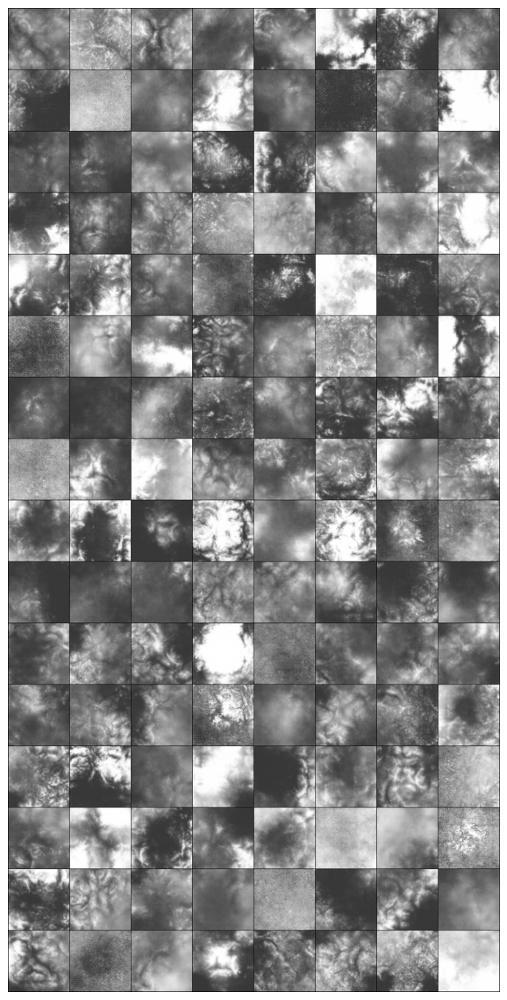

saved epoch 77
[78/86][0/660]	Loss_D: -0.0359	Loss_G: -0.4821	D(x): 0.5035	D(G(z)): 0.4676 / 0.4821
[78/86][50/660]	Loss_D: -0.0279	Loss_G: -0.5196	D(x): 0.4747	D(G(z)): 0.4468 / 0.5196
[78/86][100/660]	Loss_D: -0.0220	Loss_G: -0.4803	D(x): 0.5071	D(G(z)): 0.4852 / 0.4803
[78/86][150/660]	Loss_D: -0.0302	Loss_G: -0.4672	D(x): 0.4983	D(G(z)): 0.4680 / 0.4672
[78/86][200/660]	Loss_D: -0.0241	Loss_G: -0.4683	D(x): 0.4813	D(G(z)): 0.4572 / 0.4683
[78/86][250/660]	Loss_D: -0.0315	Loss_G: -0.4841	D(x): 0.4847	D(G(z)): 0.4532 / 0.4841
[78/86][300/660]	Loss_D: -0.0268	Loss_G: -0.4879	D(x): 0.4810	D(G(z)): 0.4542 / 0.4879
[78/86][350/660]	Loss_D: -0.0314	Loss_G: -0.4650	D(x): 0.4956	D(G(z)): 0.4642 / 0.4650
[78/86][400/660]	Loss_D: -0.0255	Loss_G: -0.4859	D(x): 0.4834	D(G(z)): 0.4579 / 0.4859
[78/86][450/660]	Loss_D: -0.0327	Loss_G: -0.4712	D(x): 0.5024	D(G(z)): 0.4697 / 0.4712
[78/86][500/660]	Loss_D: -0.0320	Loss_G: -0.4695	D(x): 0.4949	D(G(z)): 0.4628 / 0.4695
[78/86][550/660]	Loss_D: -0.018

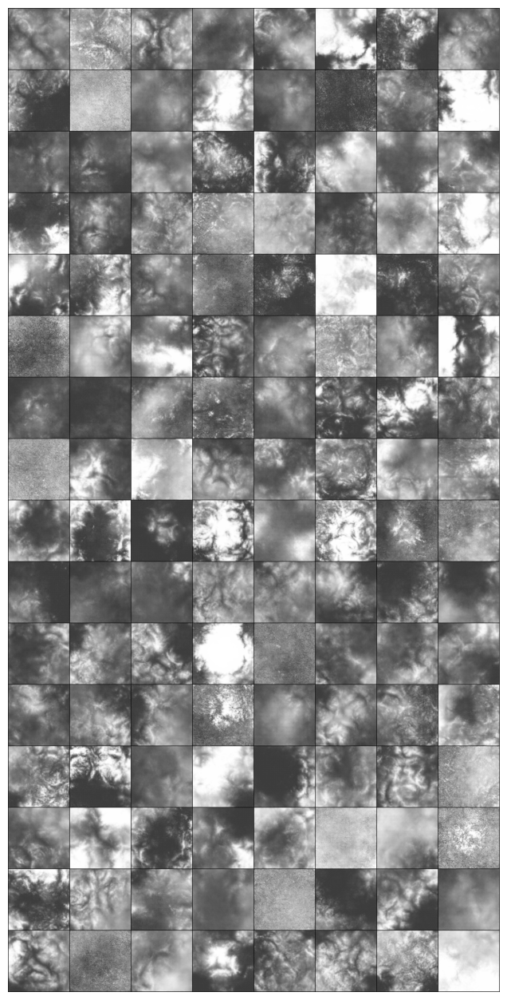

saved epoch 78
[79/86][0/660]	Loss_D: -0.0231	Loss_G: -0.4904	D(x): 0.5013	D(G(z)): 0.4782 / 0.4904
[79/86][50/660]	Loss_D: -0.0337	Loss_G: -0.4758	D(x): 0.4834	D(G(z)): 0.4497 / 0.4758
[79/86][100/660]	Loss_D: -0.0221	Loss_G: -0.5053	D(x): 0.4794	D(G(z)): 0.4573 / 0.5053
[79/86][150/660]	Loss_D: -0.0309	Loss_G: -0.4881	D(x): 0.4986	D(G(z)): 0.4677 / 0.4881
[79/86][200/660]	Loss_D: -0.0280	Loss_G: -0.4674	D(x): 0.4854	D(G(z)): 0.4573 / 0.4674
[79/86][250/660]	Loss_D: -0.0286	Loss_G: -0.4823	D(x): 0.4957	D(G(z)): 0.4671 / 0.4823
[79/86][300/660]	Loss_D: -0.0157	Loss_G: -0.4745	D(x): 0.4894	D(G(z)): 0.4737 / 0.4745
[79/86][350/660]	Loss_D: -0.0206	Loss_G: -0.5650	D(x): 0.5612	D(G(z)): 0.5406 / 0.5650
[79/86][400/660]	Loss_D: -0.0202	Loss_G: -0.4846	D(x): 0.4984	D(G(z)): 0.4781 / 0.4846
[79/86][450/660]	Loss_D: -0.0178	Loss_G: -0.5112	D(x): 0.5689	D(G(z)): 0.5511 / 0.5112
[79/86][500/660]	Loss_D: -0.0203	Loss_G: -0.5081	D(x): 0.5632	D(G(z)): 0.5430 / 0.5081
[79/86][550/660]	Loss_D: -0.008

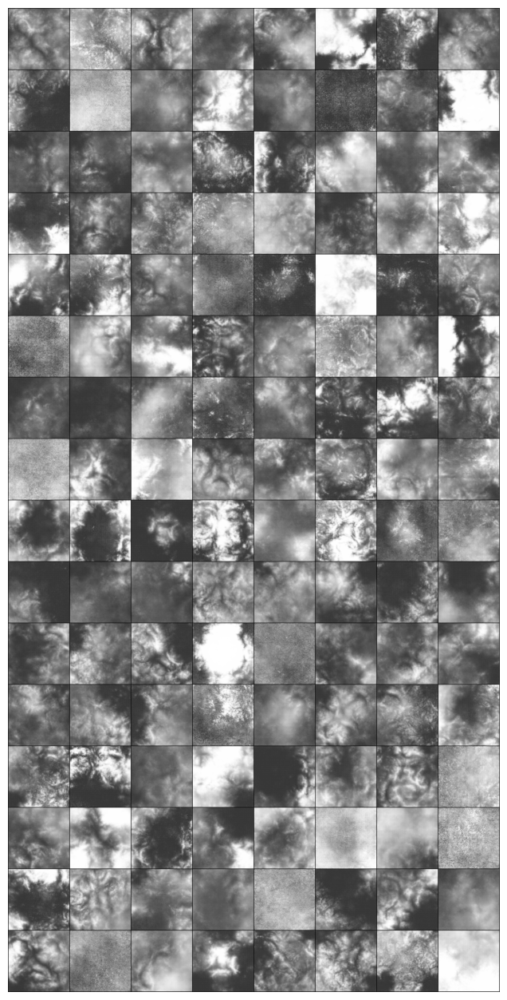

saved epoch 79
[80/86][0/660]	Loss_D: -0.0338	Loss_G: -0.5544	D(x): 0.5373	D(G(z)): 0.5035 / 0.5544
[80/86][50/660]	Loss_D: -0.0190	Loss_G: -0.5445	D(x): 0.5381	D(G(z)): 0.5191 / 0.5445
[80/86][100/660]	Loss_D: -0.0198	Loss_G: -0.5229	D(x): 0.5008	D(G(z)): 0.4810 / 0.5229
[80/86][150/660]	Loss_D: -0.0198	Loss_G: -0.5800	D(x): 0.5153	D(G(z)): 0.4955 / 0.5800
[80/86][200/660]	Loss_D: -0.0188	Loss_G: -0.5125	D(x): 0.5848	D(G(z)): 0.5660 / 0.5125
[80/86][250/660]	Loss_D: -0.0206	Loss_G: -0.5860	D(x): 0.5882	D(G(z)): 0.5676 / 0.5860
[80/86][300/660]	Loss_D: -0.0181	Loss_G: -0.5055	D(x): 0.5556	D(G(z)): 0.5376 / 0.5055
[80/86][350/660]	Loss_D: -0.0237	Loss_G: -0.5165	D(x): 0.5670	D(G(z)): 0.5433 / 0.5165
[80/86][400/660]	Loss_D: -0.0270	Loss_G: -0.5021	D(x): 0.5682	D(G(z)): 0.5413 / 0.5021
[80/86][450/660]	Loss_D: -0.0330	Loss_G: -0.4995	D(x): 0.5848	D(G(z)): 0.5518 / 0.4995
[80/86][500/660]	Loss_D: -0.0279	Loss_G: -0.5189	D(x): 0.5484	D(G(z)): 0.5205 / 0.5189
[80/86][550/660]	Loss_D: -0.024

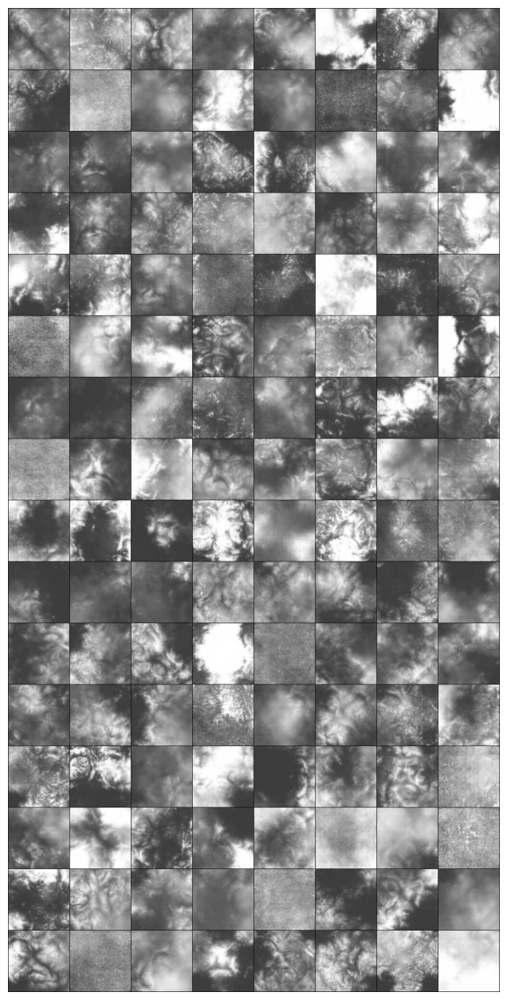

saved epoch 80
[81/86][0/660]	Loss_D: -0.0228	Loss_G: -0.5461	D(x): 0.5556	D(G(z)): 0.5328 / 0.5461
[81/86][50/660]	Loss_D: -0.0246	Loss_G: -0.5038	D(x): 0.5726	D(G(z)): 0.5480 / 0.5038
[81/86][100/660]	Loss_D: -0.0270	Loss_G: -0.5336	D(x): 0.5826	D(G(z)): 0.5556 / 0.5336
[81/86][150/660]	Loss_D: -0.0225	Loss_G: -0.5574	D(x): 0.5835	D(G(z)): 0.5609 / 0.5574
[81/86][200/660]	Loss_D: -0.0316	Loss_G: -0.5337	D(x): 0.5351	D(G(z)): 0.5035 / 0.5337
[81/86][250/660]	Loss_D: -0.0242	Loss_G: -0.5062	D(x): 0.5637	D(G(z)): 0.5395 / 0.5062
[81/86][300/660]	Loss_D: -0.0218	Loss_G: -0.5350	D(x): 0.5370	D(G(z)): 0.5152 / 0.5350
[81/86][350/660]	Loss_D: -0.0229	Loss_G: -0.5235	D(x): 0.5363	D(G(z)): 0.5134 / 0.5235
[81/86][400/660]	Loss_D: -0.0185	Loss_G: -0.5573	D(x): 0.5292	D(G(z)): 0.5107 / 0.5573
[81/86][450/660]	Loss_D: -0.0317	Loss_G: -0.4985	D(x): 0.5701	D(G(z)): 0.5384 / 0.4985
[81/86][500/660]	Loss_D: -0.0316	Loss_G: -0.5043	D(x): 0.5767	D(G(z)): 0.5450 / 0.5043
[81/86][550/660]	Loss_D: -0.018

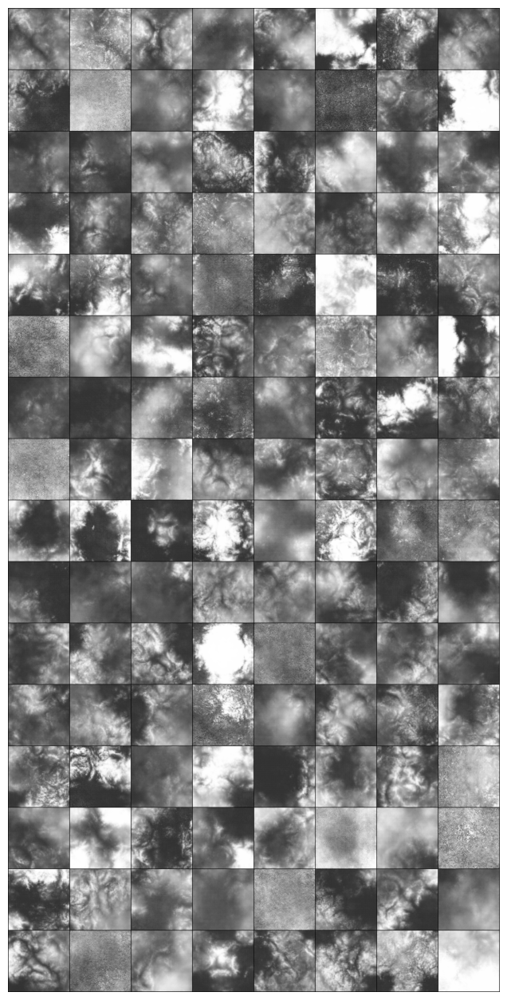

saved epoch 81
[82/86][0/660]	Loss_D: -0.0196	Loss_G: -0.5381	D(x): 0.5413	D(G(z)): 0.5217 / 0.5381
[82/86][50/660]	Loss_D: -0.0245	Loss_G: -0.5151	D(x): 0.5637	D(G(z)): 0.5393 / 0.5151
[82/86][100/660]	Loss_D: -0.0217	Loss_G: -0.5134	D(x): 0.5775	D(G(z)): 0.5558 / 0.5134
[82/86][150/660]	Loss_D: -0.0231	Loss_G: -0.5444	D(x): 0.5840	D(G(z)): 0.5609 / 0.5444
[82/86][200/660]	Loss_D: -0.0242	Loss_G: -0.5784	D(x): 0.5383	D(G(z)): 0.5140 / 0.5784
[82/86][250/660]	Loss_D: -0.0335	Loss_G: -0.4777	D(x): 0.5650	D(G(z)): 0.5315 / 0.4777
[82/86][300/660]	Loss_D: -0.0218	Loss_G: -0.5562	D(x): 0.5103	D(G(z)): 0.4884 / 0.5562
[82/86][350/660]	Loss_D: -0.0240	Loss_G: -0.5044	D(x): 0.5738	D(G(z)): 0.5498 / 0.5044
[82/86][400/660]	Loss_D: -0.0123	Loss_G: -0.5782	D(x): 0.6015	D(G(z)): 0.5893 / 0.5782
[82/86][450/660]	Loss_D: -0.0238	Loss_G: -0.5302	D(x): 0.5469	D(G(z)): 0.5231 / 0.5302
[82/86][500/660]	Loss_D: -0.0284	Loss_G: -0.5833	D(x): 0.5354	D(G(z)): 0.5070 / 0.5833
[82/86][550/660]	Loss_D: -0.022

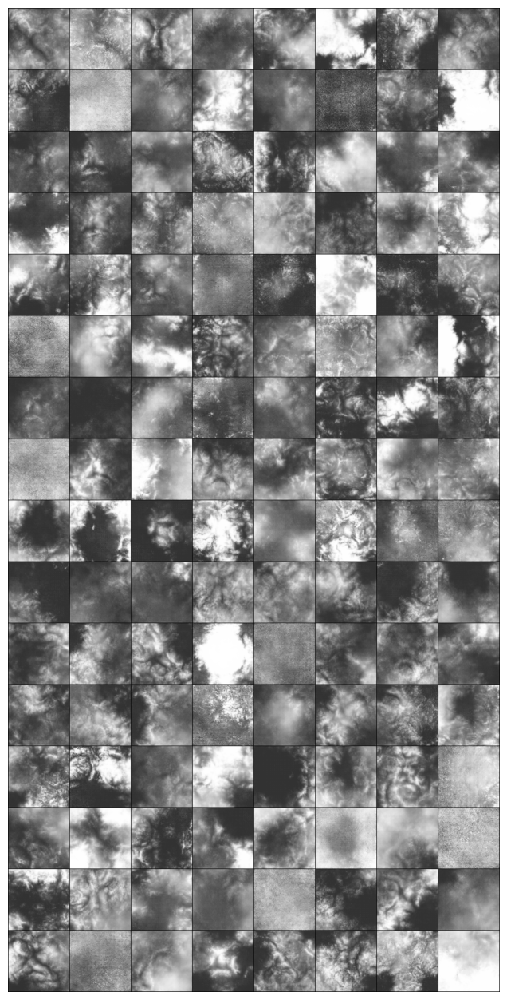

saved epoch 82
[83/86][0/660]	Loss_D: -0.0177	Loss_G: -0.5247	D(x): 0.5548	D(G(z)): 0.5371 / 0.5247
[83/86][50/660]	Loss_D: -0.0176	Loss_G: -0.5410	D(x): 0.5306	D(G(z)): 0.5129 / 0.5410
[83/86][100/660]	Loss_D: -0.0232	Loss_G: -0.5262	D(x): 0.5467	D(G(z)): 0.5235 / 0.5262
[83/86][150/660]	Loss_D: -0.0128	Loss_G: -0.5061	D(x): 0.5051	D(G(z)): 0.4924 / 0.5061
[83/86][200/660]	Loss_D: -0.0244	Loss_G: -0.5126	D(x): 0.5812	D(G(z)): 0.5569 / 0.5126
[83/86][250/660]	Loss_D: -0.0230	Loss_G: -0.5328	D(x): 0.5266	D(G(z)): 0.5036 / 0.5328
[83/86][300/660]	Loss_D: -0.0236	Loss_G: -0.5225	D(x): 0.5588	D(G(z)): 0.5351 / 0.5225
[83/86][350/660]	Loss_D: -0.0249	Loss_G: -0.5603	D(x): 0.5177	D(G(z)): 0.4927 / 0.5603
[83/86][400/660]	Loss_D: -0.0203	Loss_G: -0.5115	D(x): 0.5602	D(G(z)): 0.5399 / 0.5115
[83/86][450/660]	Loss_D: -0.0234	Loss_G: -0.5317	D(x): 0.5005	D(G(z)): 0.4771 / 0.5317
[83/86][500/660]	Loss_D: -0.0197	Loss_G: -0.5318	D(x): 0.5127	D(G(z)): 0.4931 / 0.5318
[83/86][550/660]	Loss_D: -0.021

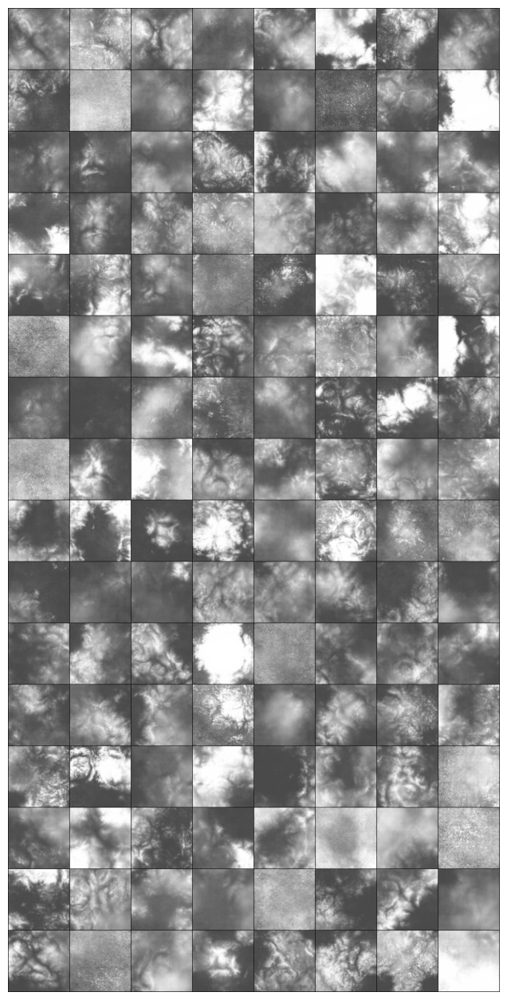

saved epoch 83
[84/86][0/660]	Loss_D: -0.0254	Loss_G: -0.5433	D(x): 0.5430	D(G(z)): 0.5175 / 0.5433
[84/86][50/660]	Loss_D: -0.0219	Loss_G: -0.5425	D(x): 0.5513	D(G(z)): 0.5294 / 0.5425
[84/86][100/660]	Loss_D: -0.0259	Loss_G: -0.5238	D(x): 0.5396	D(G(z)): 0.5137 / 0.5238
[84/86][150/660]	Loss_D: -0.0203	Loss_G: -0.5248	D(x): 0.5466	D(G(z)): 0.5264 / 0.5248
[84/86][200/660]	Loss_D: -0.0216	Loss_G: -0.5433	D(x): 0.5332	D(G(z)): 0.5117 / 0.5433
[84/86][250/660]	Loss_D: -0.0156	Loss_G: -0.5798	D(x): 0.5843	D(G(z)): 0.5687 / 0.5798
[84/86][300/660]	Loss_D: -0.0286	Loss_G: -0.4771	D(x): 0.5789	D(G(z)): 0.5503 / 0.4771
[84/86][350/660]	Loss_D: -0.0212	Loss_G: -0.5024	D(x): 0.5675	D(G(z)): 0.5463 / 0.5024
[84/86][400/660]	Loss_D: -0.0243	Loss_G: -0.5042	D(x): 0.5659	D(G(z)): 0.5416 / 0.5042
[84/86][450/660]	Loss_D: -0.0225	Loss_G: -0.5096	D(x): 0.5528	D(G(z)): 0.5303 / 0.5096
[84/86][500/660]	Loss_D: -0.0215	Loss_G: -0.5448	D(x): 0.5383	D(G(z)): 0.5168 / 0.5448
[84/86][550/660]	Loss_D: -0.030

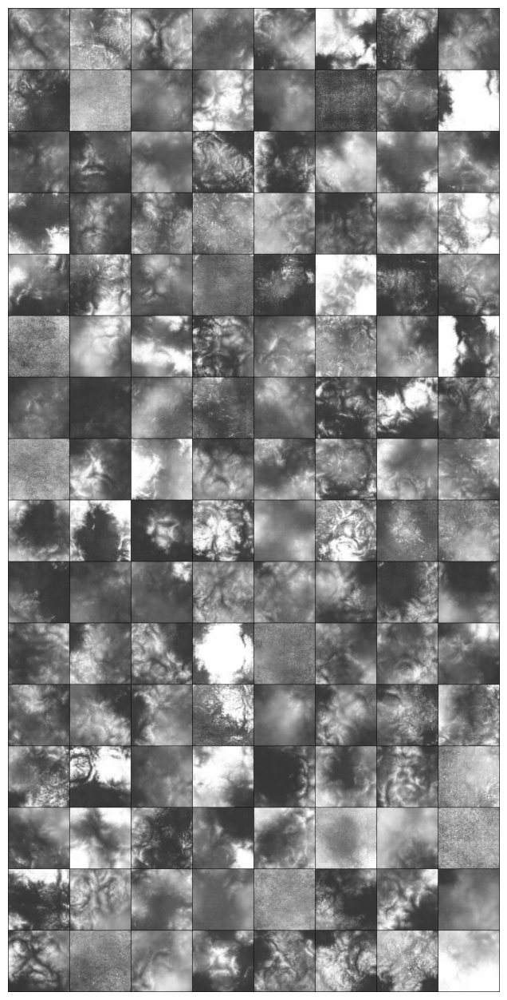

saved epoch 84
[85/86][0/660]	Loss_D: -0.0155	Loss_G: -0.4810	D(x): 0.5619	D(G(z)): 0.5464 / 0.4810
[85/86][50/660]	Loss_D: -0.0132	Loss_G: -0.4991	D(x): 0.5810	D(G(z)): 0.5678 / 0.4991
[85/86][100/660]	Loss_D: -0.0222	Loss_G: -0.5613	D(x): 0.5312	D(G(z)): 0.5090 / 0.5613
[85/86][150/660]	Loss_D: -0.0226	Loss_G: -0.5104	D(x): 0.5452	D(G(z)): 0.5227 / 0.5104
[85/86][200/660]	Loss_D: -0.0213	Loss_G: -0.5074	D(x): 0.5457	D(G(z)): 0.5245 / 0.5074
[85/86][250/660]	Loss_D: -0.0176	Loss_G: -0.5908	D(x): 0.6102	D(G(z)): 0.5926 / 0.5908
[85/86][300/660]	Loss_D: -0.0248	Loss_G: -0.4908	D(x): 0.5714	D(G(z)): 0.5466 / 0.4908
[85/86][350/660]	Loss_D: -0.0192	Loss_G: -0.5383	D(x): 0.5732	D(G(z)): 0.5540 / 0.5383
[85/86][400/660]	Loss_D: -0.0213	Loss_G: -0.5325	D(x): 0.5480	D(G(z)): 0.5267 / 0.5325
[85/86][450/660]	Loss_D: -0.0204	Loss_G: -0.5547	D(x): 0.5235	D(G(z)): 0.5031 / 0.5547
[85/86][500/660]	Loss_D: -0.0191	Loss_G: -0.4822	D(x): 0.5975	D(G(z)): 0.5784 / 0.4822
[85/86][550/660]	Loss_D: -0.019

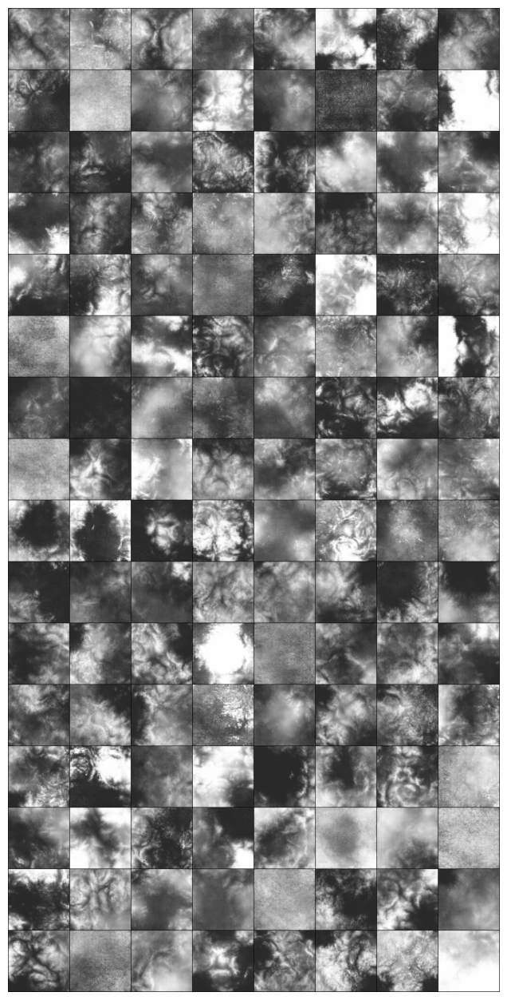

saved epoch 85
[86/86][0/660]	Loss_D: -0.0082	Loss_G: -0.5409	D(x): 0.5364	D(G(z)): 0.5282 / 0.5409
[86/86][50/660]	Loss_D: -0.0269	Loss_G: -0.4942	D(x): 0.5479	D(G(z)): 0.5209 / 0.4942
[86/86][100/660]	Loss_D: -0.0234	Loss_G: -0.5368	D(x): 0.5620	D(G(z)): 0.5386 / 0.5368
[86/86][150/660]	Loss_D: -0.0155	Loss_G: -0.5851	D(x): 0.6042	D(G(z)): 0.5887 / 0.5851
[86/86][200/660]	Loss_D: -0.0255	Loss_G: -0.4848	D(x): 0.5622	D(G(z)): 0.5367 / 0.4848
[86/86][250/660]	Loss_D: -0.0199	Loss_G: -0.5601	D(x): 0.4983	D(G(z)): 0.4784 / 0.5601
[86/86][300/660]	Loss_D: -0.0178	Loss_G: -0.5265	D(x): 0.5443	D(G(z)): 0.5265 / 0.5265
[86/86][350/660]	Loss_D: -0.0157	Loss_G: -0.5596	D(x): 0.5025	D(G(z)): 0.4867 / 0.5596
[86/86][400/660]	Loss_D: -0.0273	Loss_G: -0.4869	D(x): 0.5518	D(G(z)): 0.5245 / 0.4869
[86/86][450/660]	Loss_D: -0.0107	Loss_G: -0.5739	D(x): 0.6018	D(G(z)): 0.5911 / 0.5739
[86/86][500/660]	Loss_D: -0.0220	Loss_G: -0.5086	D(x): 0.5231	D(G(z)): 0.5010 / 0.5086
[86/86][550/660]	Loss_D: -0.019

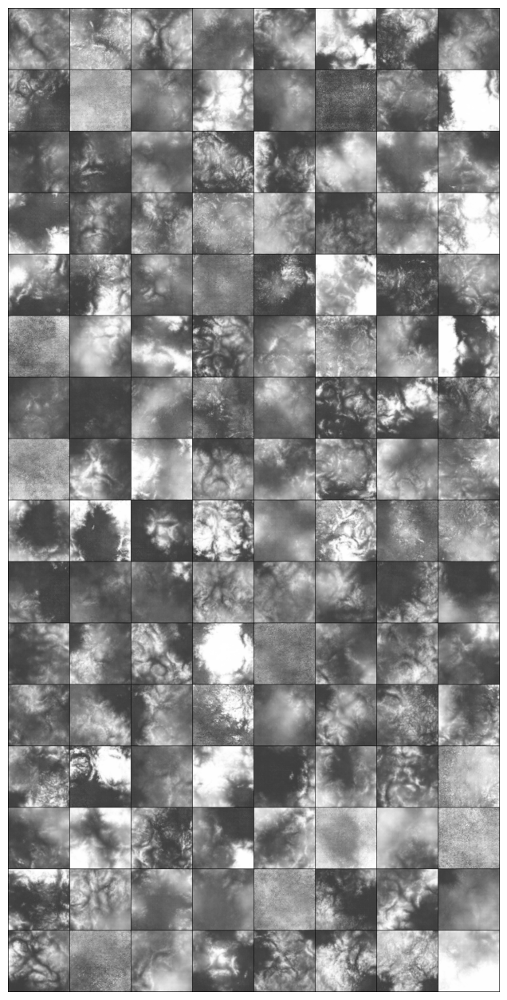

saved epoch 86


In [37]:
img_list = []
G_losses = np.load("/kaggle/input/losses/kaggle/working/losses/G_losses.pkl", allow_pickle = True)
D_losses = np.load("/kaggle/input/losses/kaggle/working/losses/D_losses.pkl", allow_pickle = True)
D_real_losses = np.load("/kaggle/input/losses/kaggle/working/losses/D_real_losses.pkl", allow_pickle = True)
D_fake_losses = np.load("/kaggle/input//losses/kaggle/working/losses/D_fake_losses.pkl", allow_pickle = True)
iters = 0

print("Starting Training Loop...")

for epoch in range(66,num_epochs+1):
    for i, data in enumerate(dataloader, 0):
        for _ in range (5):
            ##train with all reals
            netD.zero_grad()
            #setup batch
            real_cpu = data.to(device)
            b_size = real_cpu.size(0)
    #         label = torch.full((b_size,1), real_label, dtype=torch.float, device = device)

            #fwd pass thru D
            output = netD(real_cpu)
            errD_real = -torch.mean(output)
            D_x = output.mean().item()
            ##train with all fakes
            #gen batch of latent

            noise = torch.randn(b_size, 100,1,1, device = device)
            #generate fake batch by G
            fake = netG(noise)
            output = netD(fake.detach())
            D_G_z1 = output.mean().item()
            errD_fake = torch.mean(output)
            #compute errD as sum of fake and real
            errD = errD_fake + errD_real

            #update D
            errD.backward()
            optimizerD.step()
            
            with torch.no_grad():
                for name, param in netD.named_parameters():
                    if 'batch' not in name:
                        param.clamp_(-0.01,0.01)

        
        ############################
        # (2) Update G network
        ###########################
        
        netG.zero_grad()
#         label.fill_(real_label)# fake labels are real for generator cost
        noise = torch.randn(b_size, 100,1,1, device = device)
        fake = netG(noise)
        output = netD(fake)
        errG = -torch.mean(output)
#         print(errG)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        if i%50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_real_losses.append(errD_real.item())
        D_fake_losses.append(errD_fake.item())
        
    print(f"EPOCH_{epoch} OUTPUT")
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
    grid_image = vutils.make_grid(torch.cat(img_list), padding = True, normalize = True)
    processed = np.transpose(grid_image.cpu().detach().numpy(), (1, 2, 0))
    wandb.log({f"generated-{epoch}" : wandb.Image(processed)})
    print(f"logged-{epoch}")
    fig = plt.figure(figsize=(16,16))
    plt.axis("off")
#     ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
    plt.imshow(np.transpose(grid_image, (1, 2, 0)), cmap='gray')
    plt.show()

    img_list = []
        
    
    PATH = f"/kaggle/working/checkpoints/{epoch}_GAN.pt"
    torch.save({

        'Gen_state_dict': netG.state_dict(),
        'Disc_state_dict': netD.state_dict(),
        'optimizerG_state_dict': optimizerG.state_dict(),
        'optimizerD_state_dict': optimizerD.state_dict(),
    }, PATH)
    print(f"saved epoch {epoch}")
    iters += 1
PATH = f"/kaggle/working/checkpoints/last_GAN.pt"
torch.save({

    'Gen_state_dict': netG.state_dict(),
    'Disc_state_dict': netD.state_dict(),
    'optimizerG_state_dict': optimizerG.state_dict(),
    'optimizerD_state_dict': optimizerD.state_dict(),
}, PATH)

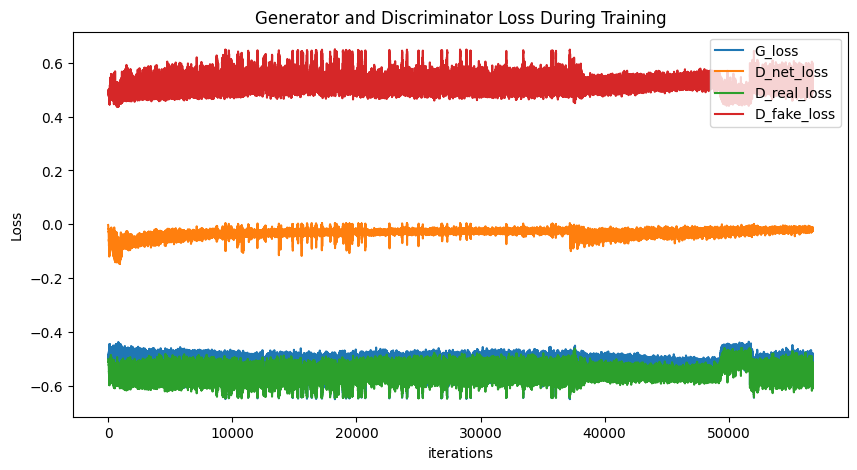

In [38]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G_loss")
plt.plot(D_losses,label="D_net_loss")
plt.plot(D_real_losses, label = "D_real_loss")
plt.plot(D_fake_losses, label = "D_fake_loss")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig("Losses graph.png")
plt.show()

In [39]:
!zip -r checkpoints.zip /kaggle/working/checkpoints

  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/85_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/last_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/76_GAN.pt (deflated 11%)
  adding: kaggle/working/checkpoints/86_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/80_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/75_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/67_GAN.pt (deflated 11%)
  adding: kaggle/working/checkpoints/81_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/71_GAN.pt (deflated 11%)
  adding: kaggle/working/checkpoints/69_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/70_GAN.pt (deflated 11%)
  adding: kaggle/working/checkpoints/82_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/83_GAN.pt (deflated 10%)
  adding: kaggle/working/checkpoints/74_GAN.pt (deflated 11%)
  adding: kaggle/working/checkpoints/66_GAN.pt (deflated 10%)
  adding: kaggle/w

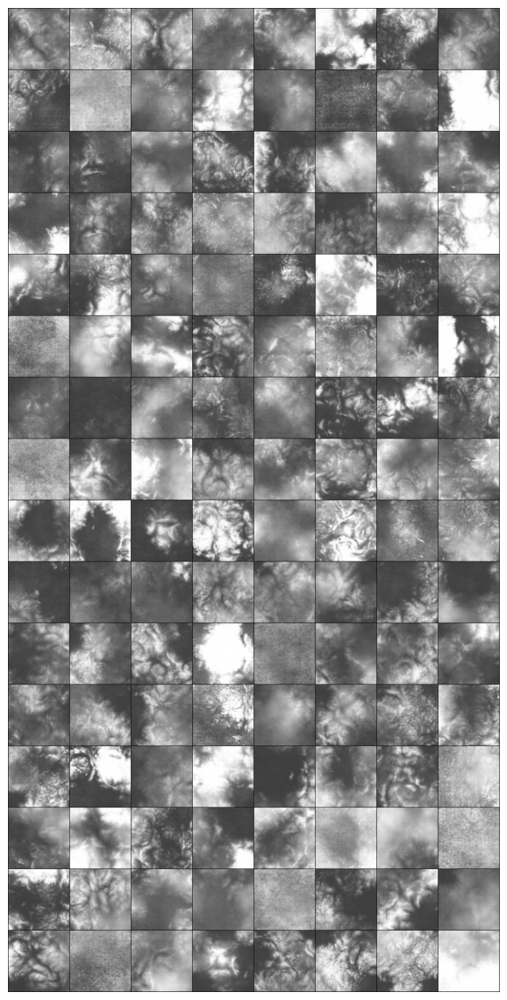

In [40]:
img_list = []
with torch.no_grad():
    fake = netG(fixed_noise).detach().cpu()
img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
plt.show()

In [41]:
!mkdir losses

In [42]:
import pickle
with open('/kaggle/working/losses/G_losses.pkl', 'wb') as f:
    pickle.dump(G_losses, f)

with open('/kaggle/working/losses/D_losses.pkl', 'wb') as f:
    pickle.dump(D_losses, f)

with open('/kaggle/working/losses/D_real_losses.pkl', 'wb') as f:
    pickle.dump(D_real_losses, f)
    
with open('/kaggle/working/losses/D_fake_losses.pkl', 'wb') as f:
    pickle.dump(D_fake_losses, f)

In [43]:
!zip -r losses.zip /kaggle/working/losses

  adding: kaggle/working/losses/ (stored 0%)
  adding: kaggle/working/losses/D_fake_losses.pkl (deflated 58%)
  adding: kaggle/working/losses/D_losses.pkl (deflated 60%)
  adding: kaggle/working/losses/D_real_losses.pkl (deflated 59%)
  adding: kaggle/working/losses/G_losses.pkl (deflated 58%)
